GAN

In [ ]:
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torchvision import datasets, transforms

In [ ]:
# MNIST Dataset
original_train_dataset = datasets.MNIST(root='./mnist_data/', train=True, transform=transforms.ToTensor(), download=True)
original_test_dataset = datasets.MNIST(root='./mnist_data/', train=False, transform=transforms.ToTensor(), download=True)

Extracting ./mnist_data/MNIST/raw/train-images-idx3-ubyte.gz to ./mnist_data/MNIST/raw


Extracting ./mnist_data/MNIST/raw/train-labels-idx1-ubyte.gz to ./mnist_data/MNIST/raw


Extracting ./mnist_data/MNIST/raw/t10k-images-idx3-ubyte.gz to ./mnist_data/MNIST/raw


Extracting ./mnist_data/MNIST/raw/t10k-labels-idx1-ubyte.gz to ./mnist_data/MNIST/raw
Processing...
Done!


/pytorch/torch/csrc/utils/tensor_numpy.cpp:141: UserWarning: The given NumPy array is not writeable, and PyTorch does not support non-writeable tensors. This means you can write to the underlying (supposedly non-writeable) NumPy array using the tensor. You may want to copy the array to protect its data or make it writeable before converting it to a tensor. This type of warning will be suppressed for the rest of this program.


In [ ]:
# Device configuration
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Set Hyper-parameters (change None)
BATCH_SIZE = 64
LEARNING_RATE_D = 0.0002
LEARNING_RATE_G = 0.0002
N_EPOCH = 100

In [ ]:
# Define Train loader
train_tensors = original_train_dataset.data.float() / 255
test_tensors = original_test_dataset.data.float() / 255

train_dataset = torch.utils.data.TensorDataset(train_tensors, original_train_dataset.targets)
test_dataset = torch.utils.data.TensorDataset(test_tensors, original_test_dataset.targets)

train_loader = torch.utils.data.DataLoader(dataset=train_dataset, batch_size=BATCH_SIZE, shuffle=True)
test_loader = torch.utils.data.DataLoader(dataset=test_dataset, batch_size=BATCH_SIZE, shuffle=False)

In [ ]:
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.dropout1 = nn.Dropout()
        self.lin=nn.Linear(784,256)
        self.lin2=nn.Linear(256,128)
        self.lin3=nn.Linear(128,64)
        self.dropout2 = nn.Dropout()
        self.lin4=nn.Linear(64,1)

    def forward(self, img):
      img=self.dropout1(img)
      img=self.lin(img)
      img=F.leaky_relu(img,.2)
      img=self.lin2(img)
      img=F.leaky_relu(img,.2)
      img=self.lin3(img)
      img=self.dropout2(img)
      img=F.leaky_relu(img,.2)
      img=self.lin4(img)
      return F.sigmoid(img)

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.lin=nn.Linear(128,128)
        self.lin2=nn.Linear(128,256)
        self.lin3=nn.Linear(256,512)
        self.lin4=nn.Linear(512,784)

    def forward(self, z):
      z=self.lin(z)
      z=F.leaky_relu(z,.2)
      z=self.lin2(z)
      z=F.leaky_relu(z,.2)
      z=self.lin3(z)
      z=F.leaky_relu(z,.2)
      z=self.lin4(z)
      return F.sigmoid(z)

D = Discriminator()
G = Generator()

In [ ]:
# Device setting
D = D
G = G

In [ ]:
# Create two optimizer for discriminator and generator (change None), you can also change the optimizer
opt_D = optim.Adam(D.parameters(), lr=LEARNING_RATE_D)
opt_G = optim.Adam(G.parameters(), lr=LEARNING_RATE_G)
# Loss function (use ".to(device)" to use gpu(cuda))
loss_function = None 

In [ ]:
import matplotlib.pyplot as plt
%matplotlib inline
plt.rcParams['figure.figsize'] = (10, 3) # set default size of plots

/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1569: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


epoch: 1 	 last batch loss D: 0.02666797861456871 	 last batch loss G: 6.139244079589844


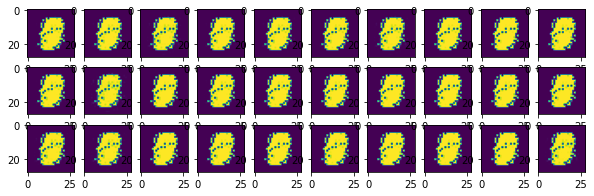

epoch: 2 	 last batch loss D: 0.09980723261833191 	 last batch loss G: 4.9837422370910645


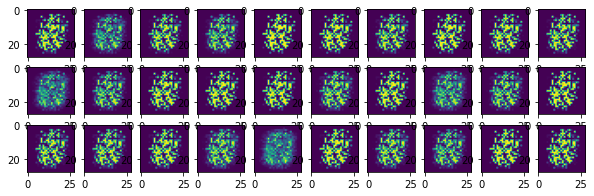

epoch: 3 	 last batch loss D: 0.43962594866752625 	 last batch loss G: 5.411602020263672


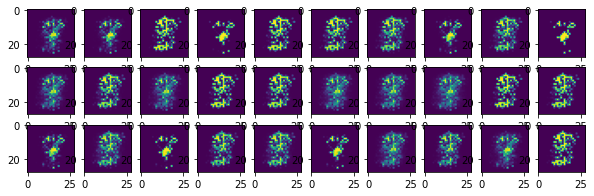

epoch: 4 	 last batch loss D: 0.311710923910141 	 last batch loss G: 3.7634994983673096


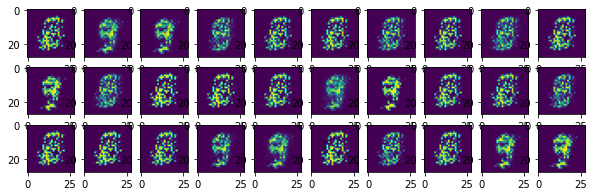

epoch: 5 	 last batch loss D: 0.6492652297019958 	 last batch loss G: 2.7285499572753906


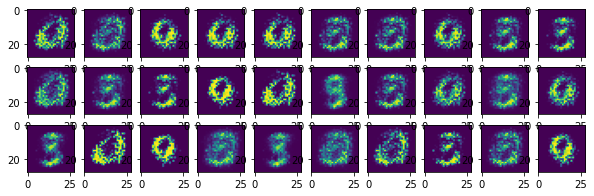

epoch: 6 	 last batch loss D: 0.8269643187522888 	 last batch loss G: 2.2483479976654053


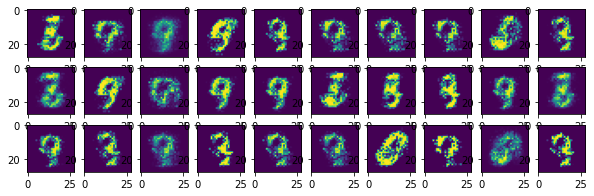

epoch: 7 	 last batch loss D: 0.7451925277709961 	 last batch loss G: 3.294562578201294


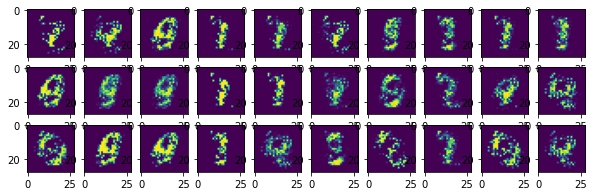

epoch: 8 	 last batch loss D: 0.871427059173584 	 last batch loss G: 3.4349217414855957


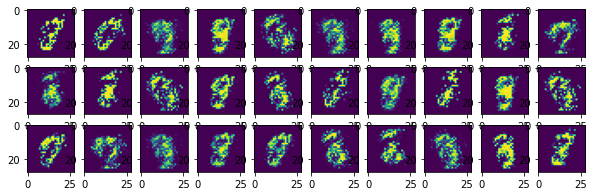

epoch: 9 	 last batch loss D: 0.3816239535808563 	 last batch loss G: 3.8986802101135254


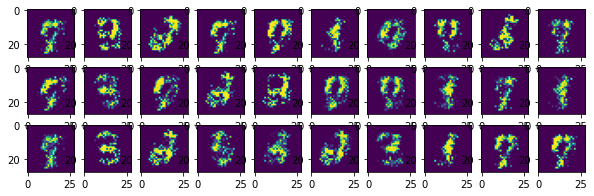

epoch: 10 	 last batch loss D: 0.547153890132904 	 last batch loss G: 2.1774144172668457


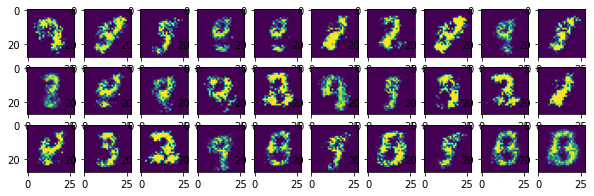

epoch: 11 	 last batch loss D: 0.2886909246444702 	 last batch loss G: 3.1604690551757812


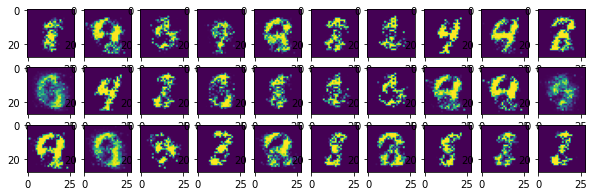

epoch: 12 	 last batch loss D: 0.6996315717697144 	 last batch loss G: 2.6244490146636963


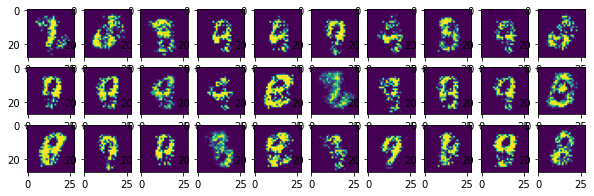

epoch: 13 	 last batch loss D: 0.40892699360847473 	 last batch loss G: 3.1742265224456787


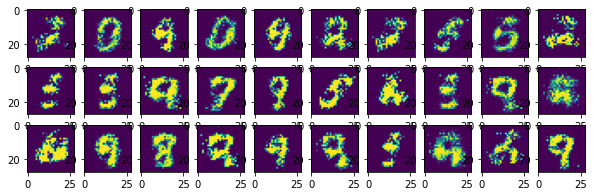

epoch: 14 	 last batch loss D: 0.4712910056114197 	 last batch loss G: 2.4385130405426025


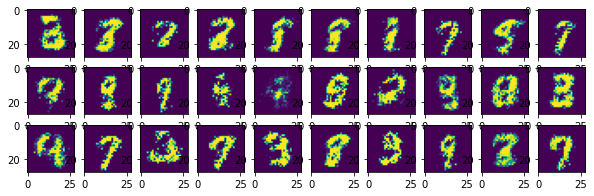

epoch: 15 	 last batch loss D: 0.4890580177307129 	 last batch loss G: 2.7694811820983887


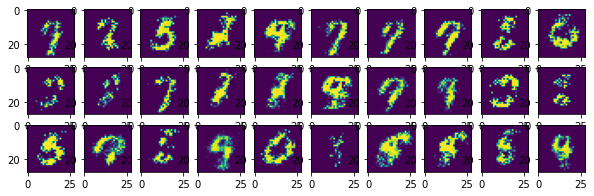

epoch: 16 	 last batch loss D: 0.766287088394165 	 last batch loss G: 2.316096544265747


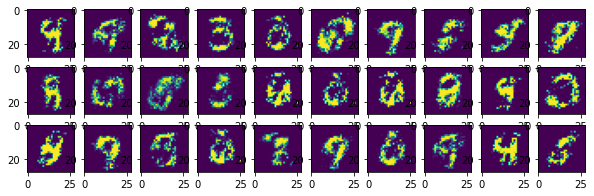

epoch: 17 	 last batch loss D: 0.5928030014038086 	 last batch loss G: 2.6871156692504883


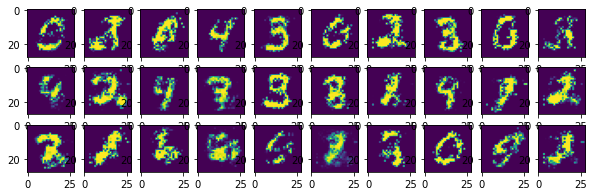

epoch: 18 	 last batch loss D: 0.932437539100647 	 last batch loss G: 1.6748870611190796


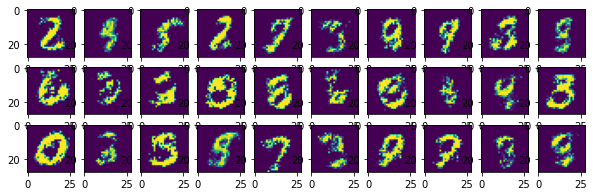

epoch: 19 	 last batch loss D: 0.7040207386016846 	 last batch loss G: 1.824467658996582


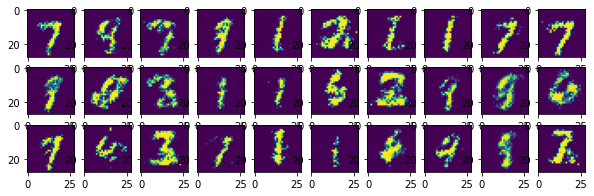

epoch: 20 	 last batch loss D: 0.7927793860435486 	 last batch loss G: 2.1442806720733643


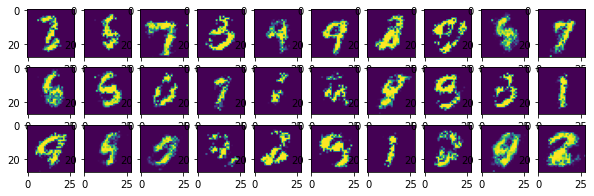

epoch: 21 	 last batch loss D: 0.9620246887207031 	 last batch loss G: 1.3153256177902222


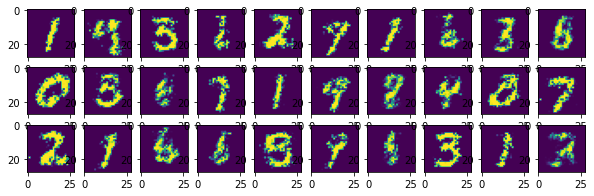

epoch: 22 	 last batch loss D: 1.0265491008758545 	 last batch loss G: 1.6254944801330566


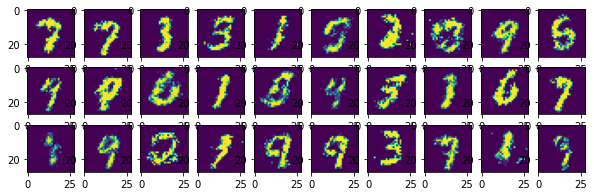

epoch: 23 	 last batch loss D: 0.9431188106536865 	 last batch loss G: 1.3468714952468872


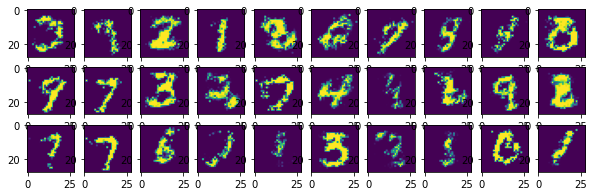

epoch: 24 	 last batch loss D: 0.9174697399139404 	 last batch loss G: 1.2470232248306274


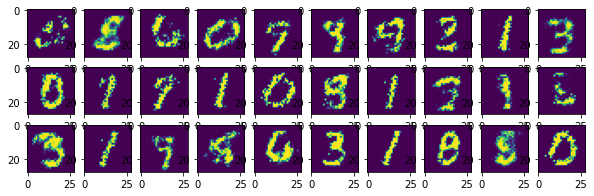

epoch: 25 	 last batch loss D: 1.1729953289031982 	 last batch loss G: 1.5285828113555908


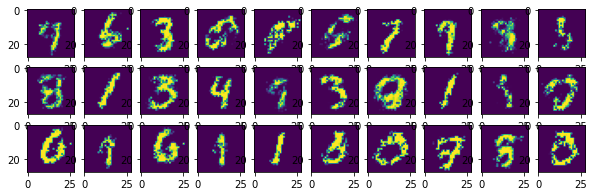

epoch: 26 	 last batch loss D: 0.7761996984481812 	 last batch loss G: 1.4697178602218628


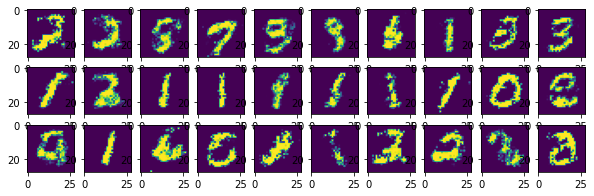

epoch: 27 	 last batch loss D: 1.0618966817855835 	 last batch loss G: 1.102893590927124


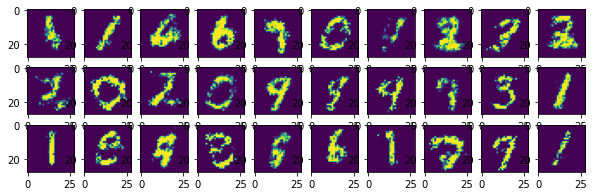

epoch: 28 	 last batch loss D: 1.1035752296447754 	 last batch loss G: 1.3057467937469482


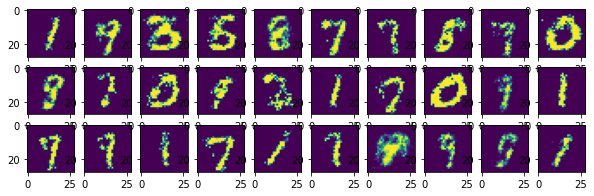

epoch: 29 	 last batch loss D: 1.215530514717102 	 last batch loss G: 1.1420776844024658


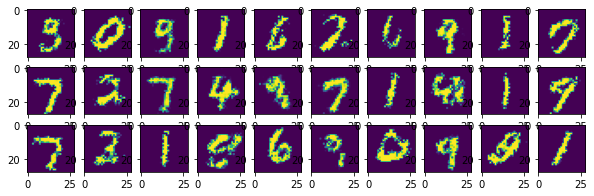

epoch: 30 	 last batch loss D: 1.133359432220459 	 last batch loss G: 1.1902191638946533


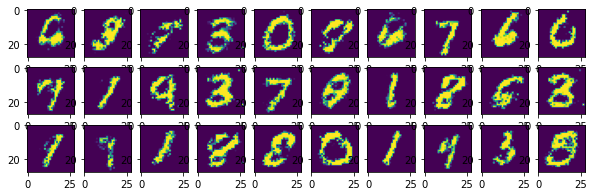

epoch: 31 	 last batch loss D: 1.1214791536331177 	 last batch loss G: 1.25668466091156


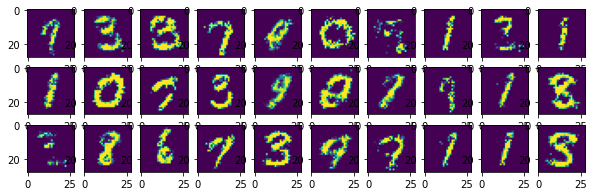

epoch: 32 	 last batch loss D: 1.0732054710388184 	 last batch loss G: 1.0105502605438232


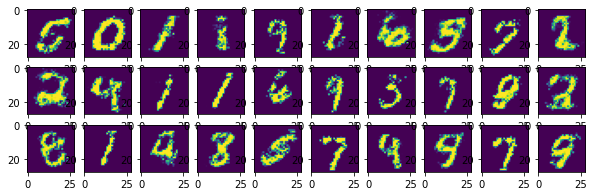

epoch: 33 	 last batch loss D: 1.3343760967254639 	 last batch loss G: 1.0195116996765137


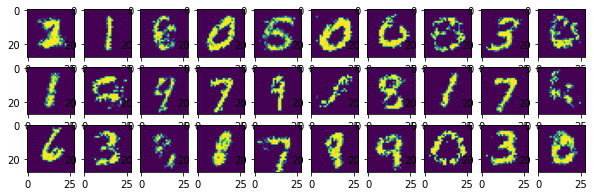

epoch: 34 	 last batch loss D: 1.345355749130249 	 last batch loss G: 1.1833689212799072


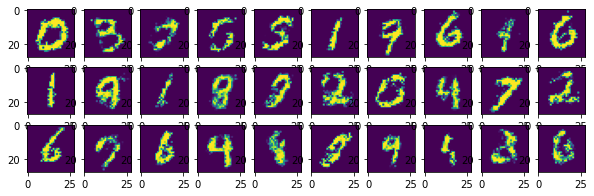

epoch: 35 	 last batch loss D: 1.2034580707550049 	 last batch loss G: 1.106648564338684


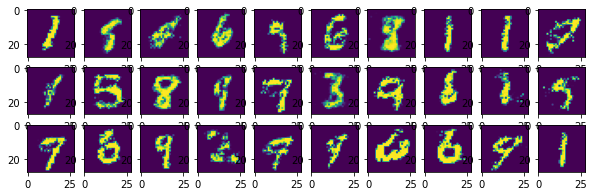

epoch: 36 	 last batch loss D: 1.1902337074279785 	 last batch loss G: 1.10486900806427


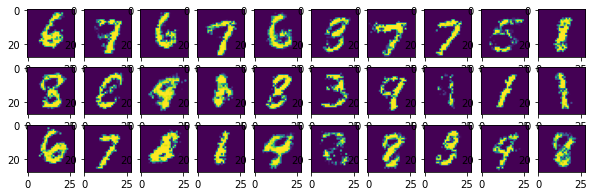

epoch: 37 	 last batch loss D: 1.0616291761398315 	 last batch loss G: 1.117538571357727


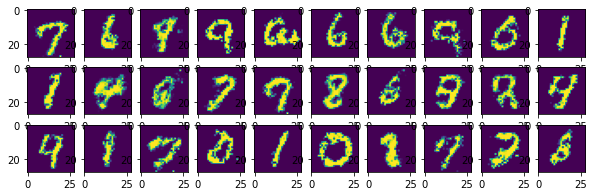

epoch: 38 	 last batch loss D: 1.0832901000976562 	 last batch loss G: 1.1721402406692505


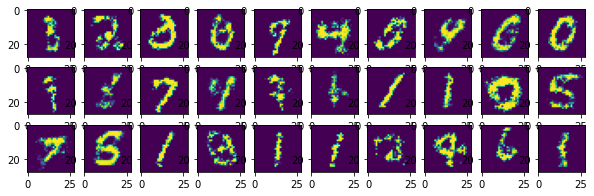

epoch: 39 	 last batch loss D: 1.1108055114746094 	 last batch loss G: 0.9022045135498047


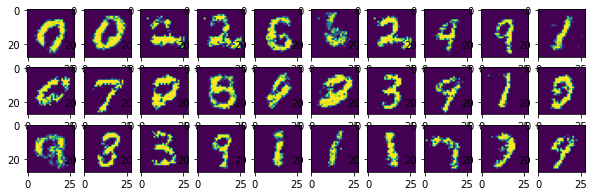

epoch: 40 	 last batch loss D: 1.041145920753479 	 last batch loss G: 1.1046867370605469


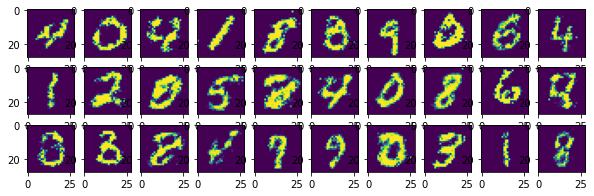

epoch: 41 	 last batch loss D: 1.1094177961349487 	 last batch loss G: 0.9344223141670227


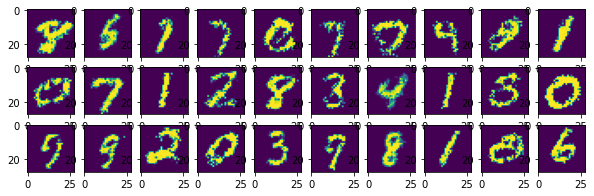

epoch: 42 	 last batch loss D: 1.1920356750488281 	 last batch loss G: 0.9245117902755737


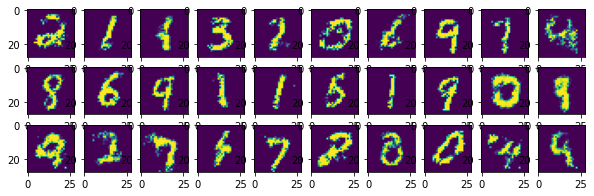

epoch: 43 	 last batch loss D: 1.1399551630020142 	 last batch loss G: 0.9605068564414978


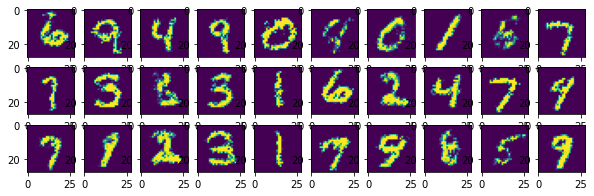

epoch: 44 	 last batch loss D: 1.1345734596252441 	 last batch loss G: 1.1106057167053223


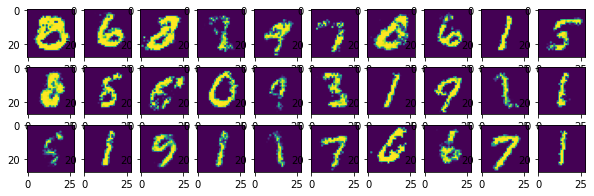

epoch: 45 	 last batch loss D: 1.2975757122039795 	 last batch loss G: 1.0754927396774292


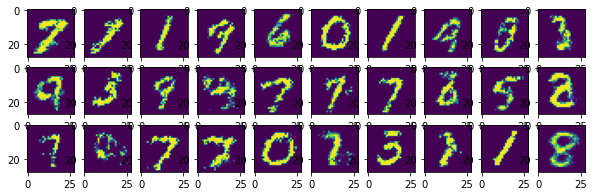

epoch: 46 	 last batch loss D: 1.44350266456604 	 last batch loss G: 1.1435192823410034


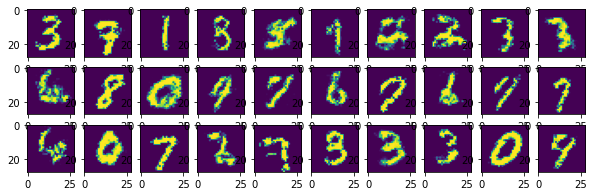

epoch: 47 	 last batch loss D: 1.1420869827270508 	 last batch loss G: 0.9029614925384521


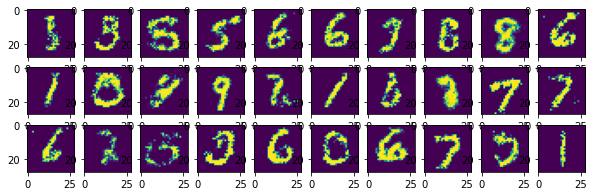

epoch: 48 	 last batch loss D: 1.2632079124450684 	 last batch loss G: 1.122680902481079


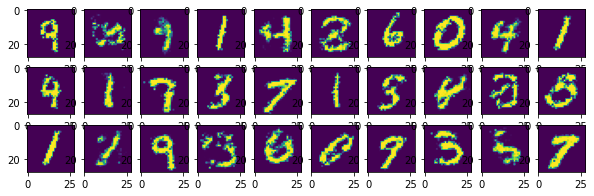

epoch: 49 	 last batch loss D: 1.1997859477996826 	 last batch loss G: 1.0493903160095215


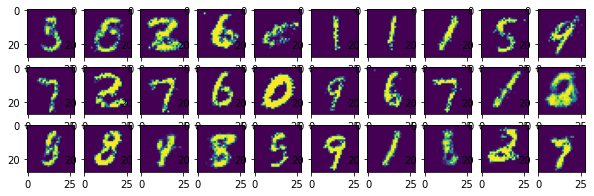

epoch: 50 	 last batch loss D: 1.1961572170257568 	 last batch loss G: 1.0650752782821655


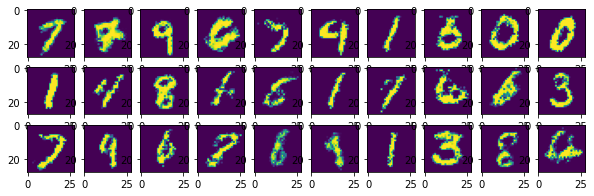

epoch: 51 	 last batch loss D: 1.0562314987182617 	 last batch loss G: 0.9198170304298401


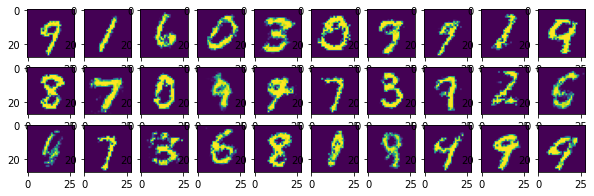

epoch: 52 	 last batch loss D: 1.124262809753418 	 last batch loss G: 0.9661338925361633


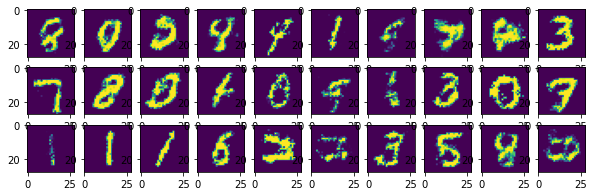

epoch: 53 	 last batch loss D: 1.1192126274108887 	 last batch loss G: 1.1987980604171753


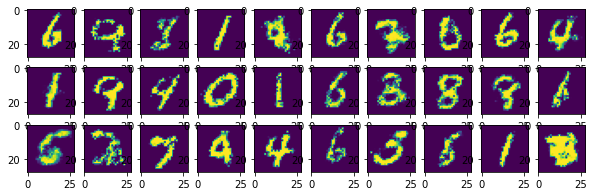

epoch: 54 	 last batch loss D: 1.2282168865203857 	 last batch loss G: 1.122331976890564


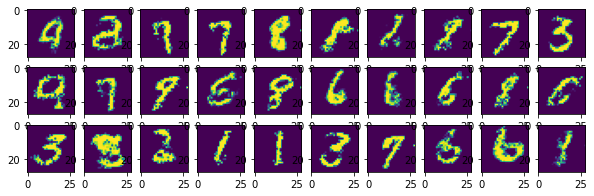

epoch: 55 	 last batch loss D: 1.132286548614502 	 last batch loss G: 0.8921980857849121


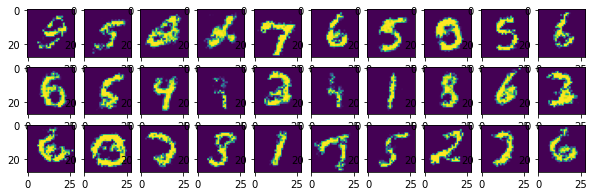

epoch: 56 	 last batch loss D: 1.4338059425354004 	 last batch loss G: 0.8875876069068909


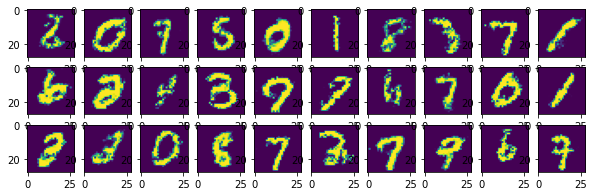

epoch: 57 	 last batch loss D: 1.1181938648223877 	 last batch loss G: 1.1027992963790894


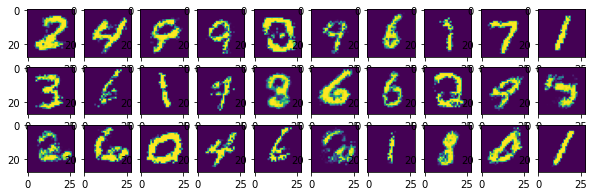

epoch: 58 	 last batch loss D: 1.363666296005249 	 last batch loss G: 0.9140856266021729


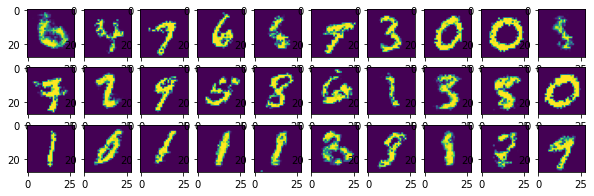

epoch: 59 	 last batch loss D: 1.3923115730285645 	 last batch loss G: 0.8606433272361755


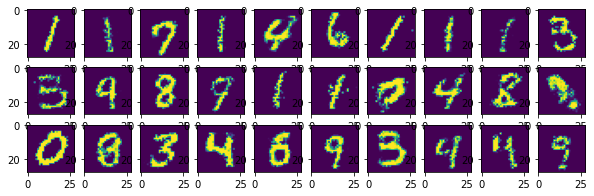

epoch: 60 	 last batch loss D: 1.2416102886199951 	 last batch loss G: 0.9357526898384094


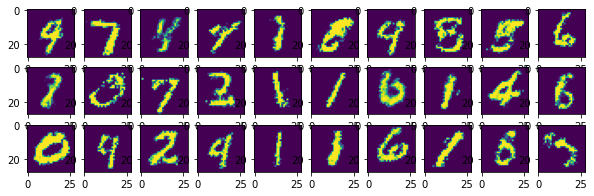

epoch: 61 	 last batch loss D: 1.1175031661987305 	 last batch loss G: 1.0475435256958008


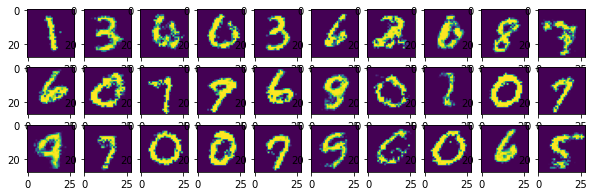

epoch: 62 	 last batch loss D: 1.3037281036376953 	 last batch loss G: 1.0014287233352661


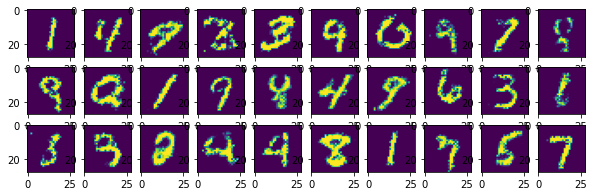

epoch: 63 	 last batch loss D: 1.168980360031128 	 last batch loss G: 0.9615989923477173


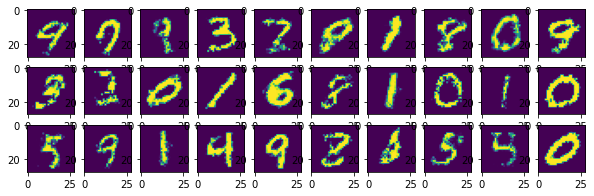

epoch: 64 	 last batch loss D: 1.1712894439697266 	 last batch loss G: 0.8946986794471741


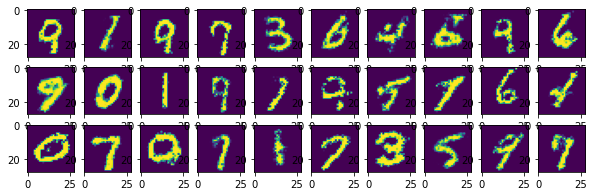

epoch: 65 	 last batch loss D: 1.2285596132278442 	 last batch loss G: 0.9884002804756165


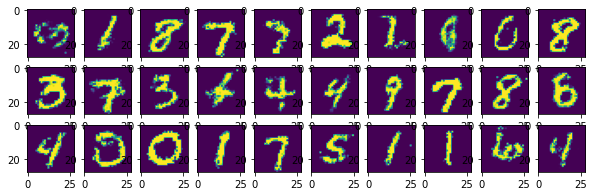

epoch: 66 	 last batch loss D: 1.2189379930496216 	 last batch loss G: 1.0180809497833252


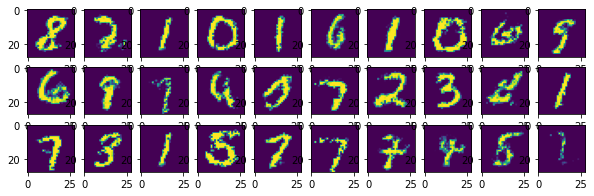

epoch: 67 	 last batch loss D: 1.287705898284912 	 last batch loss G: 0.9056432247161865


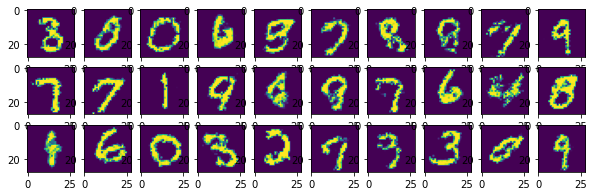

epoch: 68 	 last batch loss D: 1.2513954639434814 	 last batch loss G: 0.9025701880455017


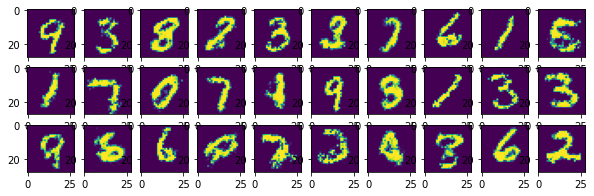

epoch: 69 	 last batch loss D: 1.3918275833129883 	 last batch loss G: 0.829969584941864


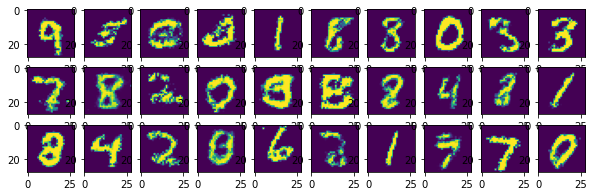

epoch: 70 	 last batch loss D: 1.286309003829956 	 last batch loss G: 1.0052225589752197


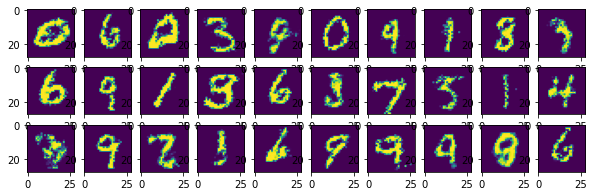

epoch: 71 	 last batch loss D: 1.4227640628814697 	 last batch loss G: 0.8779171705245972


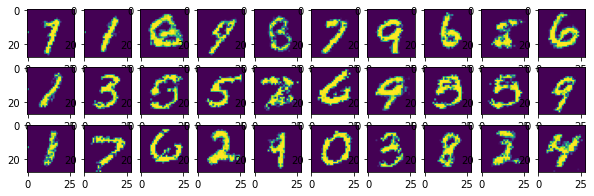

epoch: 72 	 last batch loss D: 1.4205667972564697 	 last batch loss G: 0.9062325358390808


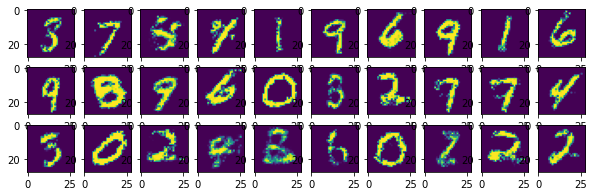

epoch: 73 	 last batch loss D: 1.2096019983291626 	 last batch loss G: 0.9371707439422607


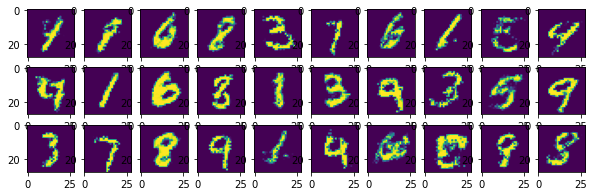

epoch: 74 	 last batch loss D: 1.316755771636963 	 last batch loss G: 0.976433515548706


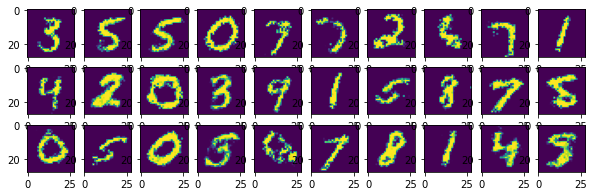

epoch: 75 	 last batch loss D: 1.3889118432998657 	 last batch loss G: 0.8695168495178223


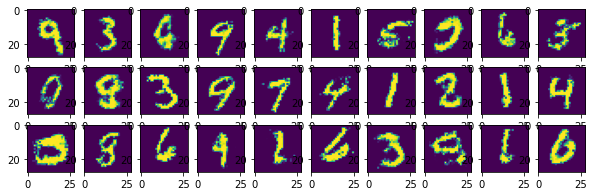

epoch: 76 	 last batch loss D: 1.31391179561615 	 last batch loss G: 0.9457071423530579


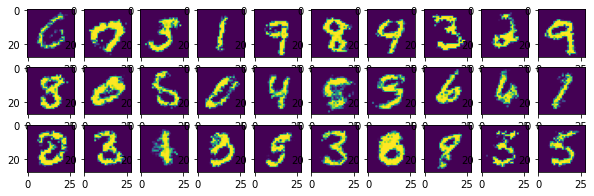

epoch: 77 	 last batch loss D: 1.272804856300354 	 last batch loss G: 0.7782630324363708


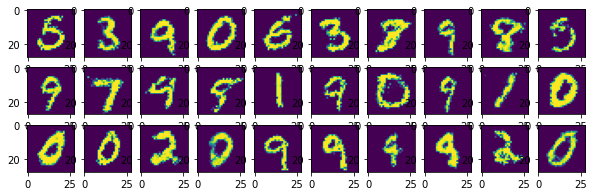

epoch: 78 	 last batch loss D: 1.3715319633483887 	 last batch loss G: 0.8635335564613342


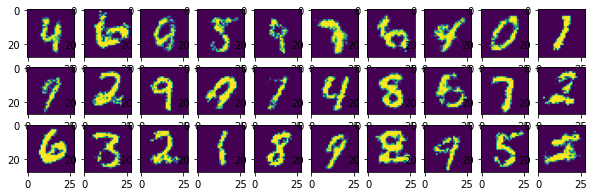

epoch: 79 	 last batch loss D: 1.274067759513855 	 last batch loss G: 0.9098684787750244


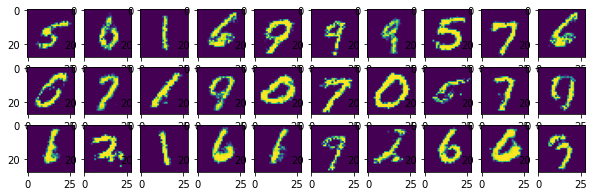

epoch: 80 	 last batch loss D: 1.3623578548431396 	 last batch loss G: 0.9837877750396729


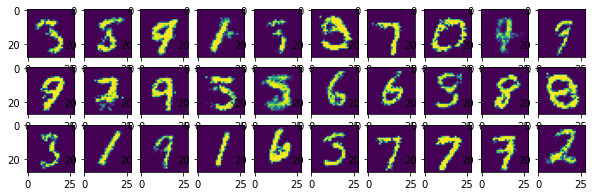

epoch: 81 	 last batch loss D: 1.2393765449523926 	 last batch loss G: 0.761947751045227


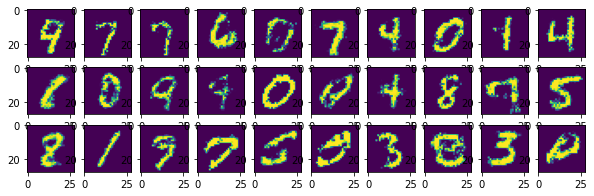

epoch: 82 	 last batch loss D: 1.2665512561798096 	 last batch loss G: 0.8448907136917114


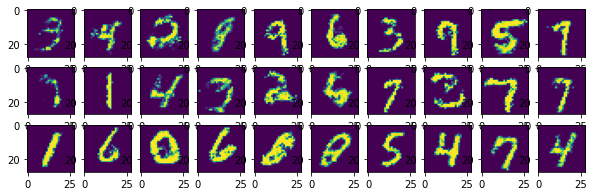

epoch: 83 	 last batch loss D: 1.2957415580749512 	 last batch loss G: 0.8552001714706421


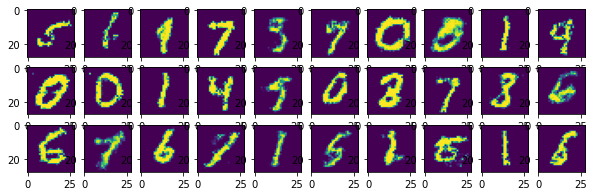

epoch: 84 	 last batch loss D: 1.1990174055099487 	 last batch loss G: 0.862880289554596


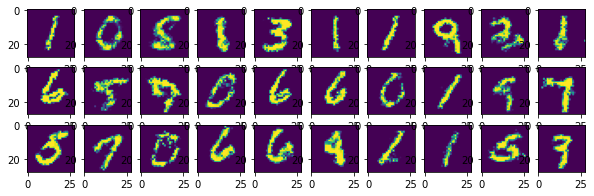

epoch: 85 	 last batch loss D: 1.3304929733276367 	 last batch loss G: 1.0336925983428955


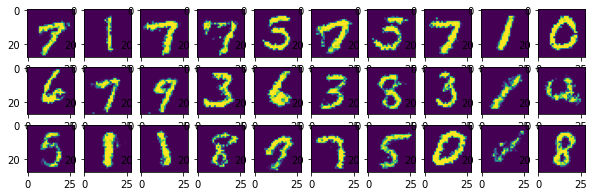

epoch: 86 	 last batch loss D: 1.3650624752044678 	 last batch loss G: 0.8898862600326538


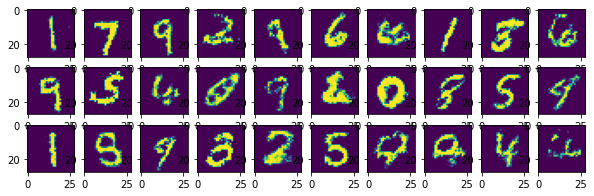

epoch: 87 	 last batch loss D: 1.359015703201294 	 last batch loss G: 0.9559838175773621


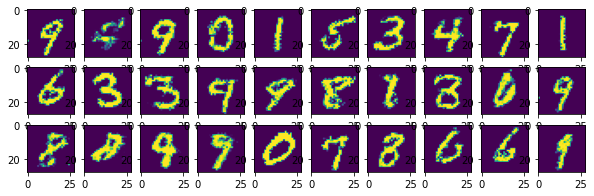

epoch: 88 	 last batch loss D: 1.2841770648956299 	 last batch loss G: 0.8188227415084839


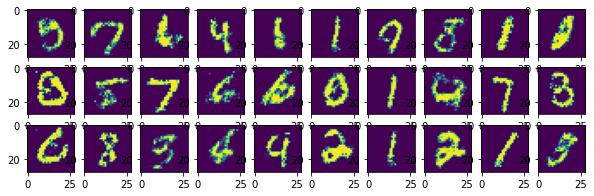

epoch: 89 	 last batch loss D: 1.3497226238250732 	 last batch loss G: 0.7817755341529846


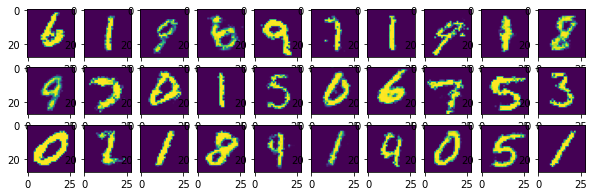

epoch: 90 	 last batch loss D: 1.254878282546997 	 last batch loss G: 0.94403076171875


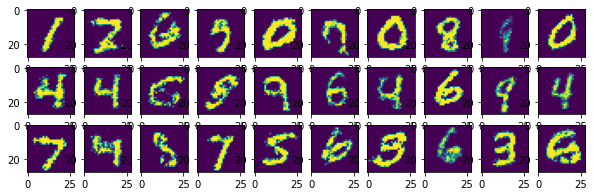

epoch: 91 	 last batch loss D: 1.2994897365570068 	 last batch loss G: 0.8809730410575867


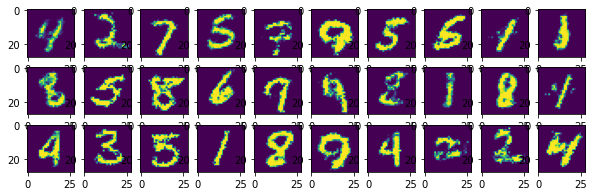

epoch: 92 	 last batch loss D: 1.3778624534606934 	 last batch loss G: 0.8909253478050232


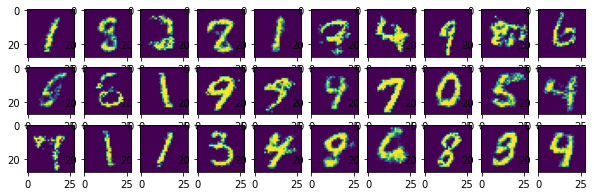

epoch: 93 	 last batch loss D: 1.4986584186553955 	 last batch loss G: 0.7605252861976624


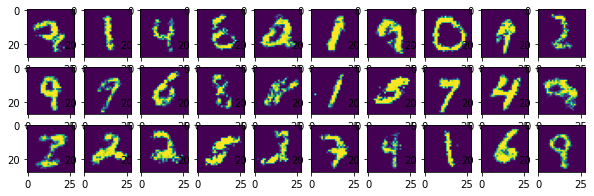

epoch: 94 	 last batch loss D: 1.3083064556121826 	 last batch loss G: 0.8487979769706726


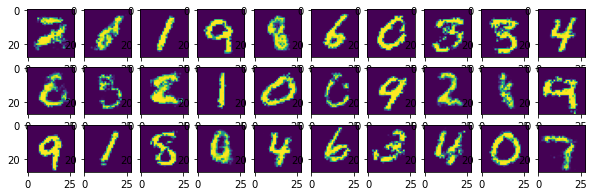

epoch: 95 	 last batch loss D: 1.2027393579483032 	 last batch loss G: 0.8132224678993225


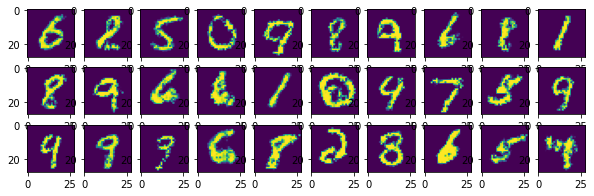

epoch: 96 	 last batch loss D: 1.2819299697875977 	 last batch loss G: 0.8023958206176758


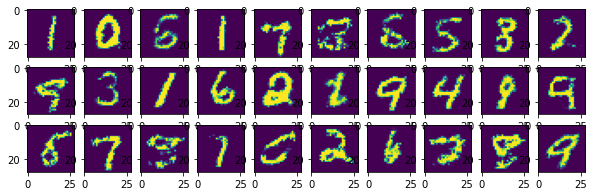

epoch: 97 	 last batch loss D: 1.2419824600219727 	 last batch loss G: 0.8495064377784729


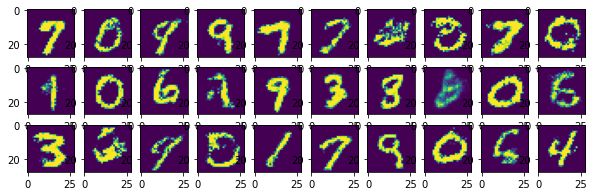

epoch: 98 	 last batch loss D: 1.4277081489562988 	 last batch loss G: 0.7830273509025574


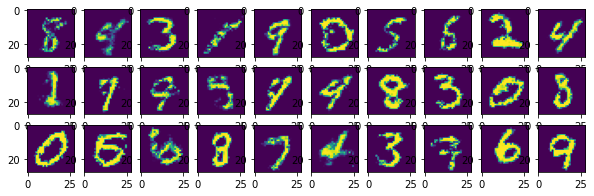

epoch: 99 	 last batch loss D: 1.253007411956787 	 last batch loss G: 0.8280788064002991


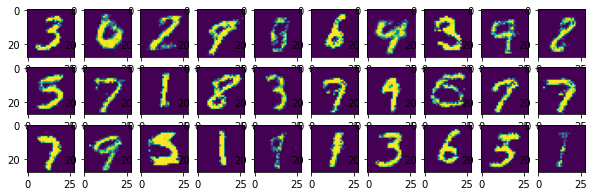

epoch: 100 	 last batch loss D: 1.313586711883545 	 last batch loss G: 0.8065961599349976


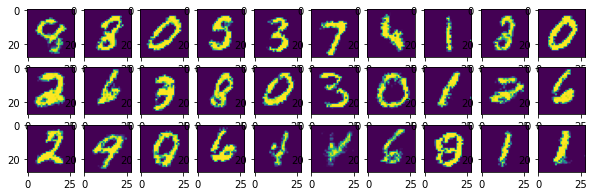

In [ ]:
for epoch in range(N_EPOCH):
    for i, (img, label) in enumerate(train_loader):
        img = img.flatten(start_dim=1)
        ######################################
        ###    if you used linear layers   ###
        ###    you have to flat images     ###
        ######################################

        real_img = img
        
        fake_labels = torch.zeros(img.shape[0], 1)
        real_labels = torch.ones(img.shape[0], 1)

        ######################################
        ###     training discriminator     ###
        ### define loss_d for dicriminator ###
        ### be carful loss_d should not    ###
        ###        change generator !      ###
        ######################################
        
        z = torch.randn(img.shape[0], 128)
        fake_img = G(z)

        opt_D.zero_grad()
        
        loss_d = (F.binary_cross_entropy(D(fake_img.detach()), fake_labels) +
                  F.binary_cross_entropy(D(real_img), real_labels))
        
        loss_d.backward()
        opt_D.step()
        
        ######################################
        ###        training generator      ###
        ###  define loss_g for generator   ###
        ###   it is better to maximize     ###
        ###        generator loss !        ###
        ######################################
        z = torch.randn(img.shape[0], 128)
        fake_img = G(z)

        opt_G.zero_grad()
        
        loss_g =loss_g = F.binary_cross_entropy(D(fake_img), real_labels)
        
        loss_g.backward()
        opt_G.step()

    
    print("epoch: {} \t last batch loss D: {} \t last batch loss G: {}".format(epoch + 1, 
                                                                               loss_d.item(), 
                                                                               loss_g.item()))

    for i in range(3):
        for j in range(10):
            plt.subplot(3, 10, i * 10 + j + 1)
            plt.imshow(fake_img[i * 10 + j].detach().cpu().view(28, 28).numpy())
    plt.show()



DCGAN(Tensorflow1)

In [ ]:
import os
dir = os.path.join("/content/images")
if not os.path.exists(dir):
    os.mkdir(dir)

In [ ]:
from __future__ import print_function, division
%tensorflow_version 1.x magic
from keras.datasets import mnist
from keras.layers import Input, Dense, Reshape, Flatten, Dropout
from keras.layers import BatchNormalization, Activation, ZeroPadding2D
from keras.layers.advanced_activations import LeakyReLU
from keras.layers.convolutional import UpSampling2D, Conv2D
from keras.models import Sequential, Model
from keras.optimizers import Adam

import matplotlib.pyplot as plt

import sys

import numpy as np

class DCGAN():
    def __init__(self):
        # Input shape
        self.img_rows = 28
        self.img_cols = 28
        self.channels = 1
        self.img_shape = (self.img_rows, self.img_cols, self.channels)
        self.latent_dim = 100

        optimizer = Adam(0.0002, 0.5)

        # Build and compile the discriminator
        self.discriminator = self.build_discriminator()
        self.discriminator.compile(loss='binary_crossentropy',
            optimizer=optimizer,
            metrics=['accuracy'])

        # Build the generator
        self.generator = self.build_generator()

        # The generator takes noise as input and generates imgs
        z = Input(shape=(self.latent_dim,))
        img = self.generator(z)

        # For the combined model we will only train the generator
        self.discriminator.trainable = False

        # The discriminator takes generated images as input and determines validity
        valid = self.discriminator(img)

        # The combined model  (stacked generator and discriminator)
        # Trains the generator to fool the discriminator
        self.combined = Model(z, valid)
        self.combined.compile(loss='binary_crossentropy', optimizer=optimizer)

    def build_generator(self):

        model = Sequential()

        model.add(Dense(128 * 7 * 7, activation="relu", input_dim=self.latent_dim))
        model.add(Reshape((7, 7, 128)))
        model.add(UpSampling2D())
        model.add(Conv2D(128, kernel_size=3, padding="same"))
        model.add(BatchNormalization(momentum=0.8))
        model.add(Activation("relu"))
        model.add(UpSampling2D())
        model.add(Conv2D(64, kernel_size=3, padding="same"))
        model.add(BatchNormalization(momentum=0.8))
        model.add(Activation("relu"))
        model.add(Conv2D(self.channels, kernel_size=3, padding="same"))
        model.add(Activation("tanh"))

        model.summary()

        noise = Input(shape=(self.latent_dim,))
        img = model(noise)

        return Model(noise, img)

    def build_discriminator(self):

        model = Sequential()

        model.add(Conv2D(32, kernel_size=3, strides=2, input_shape=self.img_shape, padding="same"))
        model.add(LeakyReLU(alpha=0.2))
        model.add(Dropout(0.25))
        model.add(Conv2D(64, kernel_size=3, strides=2, padding="same"))
        model.add(ZeroPadding2D(padding=((0,1),(0,1))))
        model.add(BatchNormalization(momentum=0.8))
        model.add(LeakyReLU(alpha=0.2))
        model.add(Dropout(0.25))
        model.add(Conv2D(128, kernel_size=3, strides=2, padding="same"))
        model.add(BatchNormalization(momentum=0.8))
        model.add(LeakyReLU(alpha=0.2))
        model.add(Dropout(0.25))
        model.add(Conv2D(256, kernel_size=3, strides=1, padding="same"))
        model.add(BatchNormalization(momentum=0.8))
        model.add(LeakyReLU(alpha=0.2))
        model.add(Dropout(0.25))
        model.add(Flatten())
        model.add(Dense(1, activation='sigmoid'))

        model.summary()

        img = Input(shape=self.img_shape)
        validity = model(img)

        return Model(img, validity)

    def train(self, epochs, batch_size=128, save_interval=50):

        # Load the dataset
        (X_train, _), (_, _) = mnist.load_data()

        # Rescale -1 to 1
        X_train = X_train / 127.5 - 1.
        X_train = np.expand_dims(X_train, axis=3)

        # Adversarial ground truths
        valid = np.ones((batch_size, 1))
        fake = np.zeros((batch_size, 1))

        for epoch in range(epochs):

            # ---------------------
            #  Train Discriminator
            # ---------------------

            # Select a random half of images
            idx = np.random.randint(0, X_train.shape[0], batch_size)
            imgs = X_train[idx]

            # Sample noise and generate a batch of new images
            noise = np.random.normal(0, 1, (batch_size, self.latent_dim))
            gen_imgs = self.generator.predict(noise)

            # Train the discriminator (real classified as ones and generated as zeros)
            d_loss_real = self.discriminator.train_on_batch(imgs, valid)
            d_loss_fake = self.discriminator.train_on_batch(gen_imgs, fake)
            d_loss = 0.5 * np.add(d_loss_real, d_loss_fake)

            # ---------------------
            #  Train Generator
            # ---------------------

            # Train the generator (wants discriminator to mistake images as real)
            g_loss = self.combined.train_on_batch(noise, valid)

            # Plot the progress
            print ("%d [D loss: %f, acc.: %.2f%%] [G loss: %f]" % (epoch, d_loss[0], 100*d_loss[1], g_loss))

            # If at save interval => save generated image samples
            if epoch % save_interval == 0:
                self.save_imgs(epoch)

    def save_imgs(self, epoch):
        r, c = 5, 5
        noise = np.random.normal(0, 1, (r * c, self.latent_dim))
        gen_imgs = self.generator.predict(noise)

        # Rescale images 0 - 1
        gen_imgs = 0.5 * gen_imgs + 0.5

        fig, axs = plt.subplots(r, c)
        cnt = 0
        for i in range(r):
            for j in range(c):
                axs[i,j].imshow(gen_imgs[cnt, :,:,0], cmap='gray')
                axs[i,j].axis('off')
                cnt += 1
        fig.savefig("/content/images/mnist_%d.png" % epoch)
        plt.close()


if __name__ == '__main__':
    dcgan = DCGAN()
    dcgan.train(epochs=4000, batch_size=32, save_interval=50)

`%tensorflow_version` only switches the major version: 1.x or 2.x.
You set: `1.x magic`. This will be interpreted as: `1.x`.


TensorFlow is already loaded. Please restart the runtime to change versions.
Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_8 (Conv2D)            (None, 14, 14, 32)        320       
_________________________________________________________________
leaky_re_lu_5 (LeakyReLU)    (None, 14, 14, 32)        0         
_________________________________________________________________
dropout_5 (Dropout)          (None, 14, 14, 32)        0         
_________________________________________________________________
conv2d_9 (Conv2D)            (None, 7, 7, 64)          18496     
_________________________________________________________________
zero_padding2d_2 (ZeroPaddin (None, 8, 8, 64)          0         
________________________________________________

/usr/local/lib/python3.6/dist-packages/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
/usr/local/lib/python3.6/dist-packages/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


0 [D loss: 1.099807, acc.: 39.06%] [G loss: 0.860259]


/usr/local/lib/python3.6/dist-packages/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


1 [D loss: 0.348149, acc.: 87.50%] [G loss: 1.110315]
2 [D loss: 0.175369, acc.: 100.00%] [G loss: 1.594419]
3 [D loss: 0.106788, acc.: 100.00%] [G loss: 1.605433]
4 [D loss: 0.058905, acc.: 100.00%] [G loss: 1.541660]
5 [D loss: 0.066225, acc.: 98.44%] [G loss: 0.924203]
6 [D loss: 0.074177, acc.: 100.00%] [G loss: 0.750263]
7 [D loss: 0.091894, acc.: 98.44%] [G loss: 0.780758]
8 [D loss: 0.082804, acc.: 98.44%] [G loss: 0.964872]
9 [D loss: 0.122223, acc.: 96.88%] [G loss: 0.761267]
10 [D loss: 0.225762, acc.: 92.19%] [G loss: 1.301293]
11 [D loss: 0.356767, acc.: 81.25%] [G loss: 2.213492]
12 [D loss: 0.293695, acc.: 93.75%] [G loss: 2.515036]
13 [D loss: 0.330328, acc.: 85.94%] [G loss: 2.034347]
14 [D loss: 0.216196, acc.: 95.31%] [G loss: 1.776022]
15 [D loss: 0.071890, acc.: 100.00%] [G loss: 1.143456]
16 [D loss: 0.084109, acc.: 95.31%] [G loss: 0.651055]
17 [D loss: 0.053269, acc.: 100.00%] [G loss: 0.399571]
18 [D loss: 0.039164, acc.: 100.00%] [G loss: 0.367193]
19 [D loss: 

pix2pix(Tensorflow2)

In [ ]:
import tensorflow as tf
import os
import time
from matplotlib import pyplot as plt
from IPython import display
!pip install -q -U tensorboard

     |████████████████████████████████| 6.8MB 2.7MB/s 
ERROR: tensorflow 2.2.0 has requirement tensorboard<2.3.0,>=2.2.0, but you'll have tensorboard 2.3.0 which is incompatible.


Load Dataset

In [ ]:
_URL = 'https://people.eecs.berkeley.edu/~tinghuiz/projects/pix2pix/datasets/facades.tar.gz'

path_to_zip = tf.keras.utils.get_file('facades.tar.gz',
                                      origin=_URL,
                                      extract=True)

PATH = os.path.join(os.path.dirname(path_to_zip), 'facades/')

30171136/30168306 [==============================] - 3s 0us/step


Parameters

In [ ]:
BUFFER_SIZE = 400
BATCH_SIZE = 1
IMG_WIDTH = 256
IMG_HEIGHT = 256

In [ ]:
def load(image_file):
  image = tf.io.read_file(image_file)
  image = tf.image.decode_jpeg(image)

  w = tf.shape(image)[1]

  w = w // 2
  real_image = image[:, :w, :]
  input_image = image[:, w:, :]

  input_image = tf.cast(input_image, tf.float32)
  real_image = tf.cast(real_image, tf.float32)

  return input_image, real_image


def resize(input_image, real_image, height, width):
  input_image = tf.image.resize(input_image, [height, width],
                                method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)
  real_image = tf.image.resize(real_image, [height, width],
                               method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)

  return input_image, real_image

def random_crop(input_image, real_image):
  stacked_image = tf.stack([input_image, real_image], axis=0)
  cropped_image = tf.image.random_crop(
      stacked_image, size=[2, IMG_HEIGHT, IMG_WIDTH, 3])

  return cropped_image[0], cropped_image[1]



# normalizing the images to [-1, 1]

def normalize(input_image, real_image):
  input_image = (input_image / 127.5) - 1
  real_image = (real_image / 127.5) - 1

  return input_image, real_image


@tf.function()
def random_jitter(input_image, real_image):
  # resizing to 286 x 286 x 3
  input_image, real_image = resize(input_image, real_image, 286, 286)

  # randomly cropping to 256 x 256 x 3
  input_image, real_image = random_crop(input_image, real_image)

  if tf.random.uniform(()) > 0.5:
    # random mirroring
    input_image = tf.image.flip_left_right(input_image)
    real_image = tf.image.flip_left_right(real_image)

  return input_image, real_image

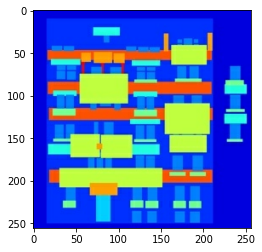

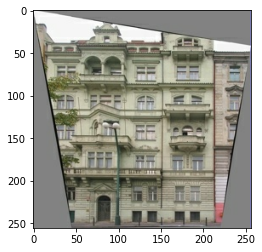

In [ ]:
inp, re = load(PATH+'train/100.jpg')
# casting to int for matplotlib to show the image
plt.figure()
plt.imshow(inp/255.0)
plt.figure()
plt.imshow(re/255.0)

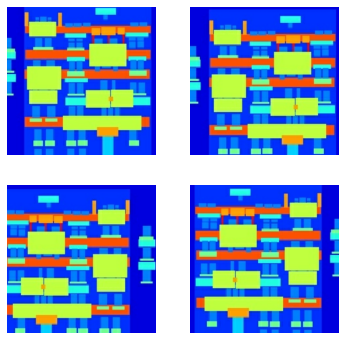

In [ ]:
plt.figure(figsize=(6, 6))
for i in range(4):
  rj_inp, rj_re = random_jitter(inp, re)
  plt.subplot(2, 2, i+1)
  plt.imshow(rj_inp/255.0)
  plt.axis('off')
plt.show()

In [ ]:
def load_image_train(image_file):
  input_image, real_image = load(image_file)
  input_image, real_image = random_jitter(input_image, real_image)
  input_image, real_image = normalize(input_image, real_image)

  return input_image, real_image
  
def load_image_test(image_file):
  input_image, real_image = load(image_file)
  input_image, real_image = resize(input_image, real_image,
                                   IMG_HEIGHT, IMG_WIDTH)
  input_image, real_image = normalize(input_image, real_image)

  return input_image, real_image

In [ ]:
train_dataset = tf.data.Dataset.list_files(PATH+'train/*.jpg')
train_dataset = train_dataset.map(load_image_train,
                                  num_parallel_calls=tf.data.experimental.AUTOTUNE)
train_dataset = train_dataset.shuffle(BUFFER_SIZE)
train_dataset = train_dataset.batch(BATCH_SIZE)
test_dataset = tf.data.Dataset.list_files(PATH+'test/*.jpg')
test_dataset = test_dataset.map(load_image_test)
test_dataset = test_dataset.batch(BATCH_SIZE)

Generator

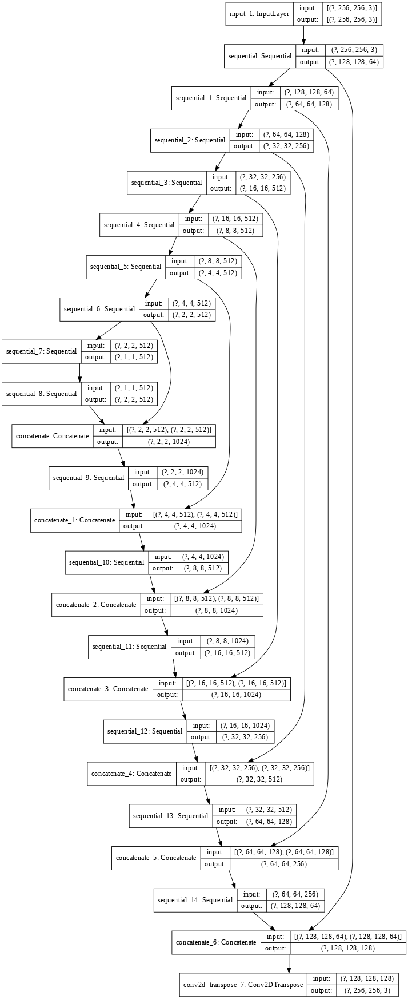

In [ ]:
def downsample(filters, size, apply_batchnorm=True):
  initializer = tf.random_normal_initializer(0., 0.02)

  result = tf.keras.Sequential()
  result.add(
      tf.keras.layers.Conv2D(filters, size, strides=2, padding='same',
                             kernel_initializer=initializer, use_bias=False))

  if apply_batchnorm:
    result.add(tf.keras.layers.BatchNormalization())

  result.add(tf.keras.layers.LeakyReLU())

  return result


def upsample(filters, size, apply_dropout=False):
  initializer = tf.random_normal_initializer(0., 0.02)

  result = tf.keras.Sequential()
  result.add(
    tf.keras.layers.Conv2DTranspose(filters, size, strides=2,
                                    padding='same',
                                    kernel_initializer=initializer,
                                    use_bias=False))

  result.add(tf.keras.layers.BatchNormalization())

  if apply_dropout:
      result.add(tf.keras.layers.Dropout(0.5))

  result.add(tf.keras.layers.ReLU())

  return result
OUTPUT_CHANNELS=3
def Generator():
  inputs = tf.keras.layers.Input(shape=[256,256,3])

  down_stack = [
    downsample(64, 4, apply_batchnorm=False), # (bs, 128, 128, 64)
    downsample(128, 4), # (bs, 64, 64, 128)
    downsample(256, 4), # (bs, 32, 32, 256)
    downsample(512, 4), # (bs, 16, 16, 512)
    downsample(512, 4), # (bs, 8, 8, 512)
    downsample(512, 4), # (bs, 4, 4, 512)
    downsample(512, 4), # (bs, 2, 2, 512)
    downsample(512, 4), # (bs, 1, 1, 512)
  ]

  up_stack = [
    upsample(512, 4, apply_dropout=True), # (bs, 2, 2, 1024)
    upsample(512, 4, apply_dropout=True), # (bs, 4, 4, 1024)
    upsample(512, 4, apply_dropout=True), # (bs, 8, 8, 1024)
    upsample(512, 4), # (bs, 16, 16, 1024)
    upsample(256, 4), # (bs, 32, 32, 512)
    upsample(128, 4), # (bs, 64, 64, 256)
    upsample(64, 4), # (bs, 128, 128, 128)
  ]

  initializer = tf.random_normal_initializer(0., 0.02)
  last = tf.keras.layers.Conv2DTranspose(OUTPUT_CHANNELS, 4,
                                         strides=2,
                                         padding='same',
                                         kernel_initializer=initializer,
                                         activation='tanh') # (bs, 256, 256, 3)

  x = inputs

  # Downsampling through the model
  skips = []
  for down in down_stack:
    x = down(x)
    skips.append(x)

  skips = reversed(skips[:-1])

  # Upsampling and establishing the skip connections
  for up, skip in zip(up_stack, skips):
    x = up(x)
    x = tf.keras.layers.Concatenate()([x, skip])

  x = last(x)

  return tf.keras.Model(inputs=inputs, outputs=x)

generator = Generator()
tf.keras.utils.plot_model(generator, show_shapes=True, dpi=64)

Training

In [ ]:
LAMBDA = 100
def generator_loss(disc_generated_output, gen_output, target):
  gan_loss = loss_object(tf.ones_like(disc_generated_output), disc_generated_output)

  # mean absolute error
  l1_loss = tf.reduce_mean(tf.abs(target - gen_output))

  total_gen_loss = gan_loss + (LAMBDA * l1_loss)

  return total_gen_loss, gan_loss, l1_loss

Discriminator

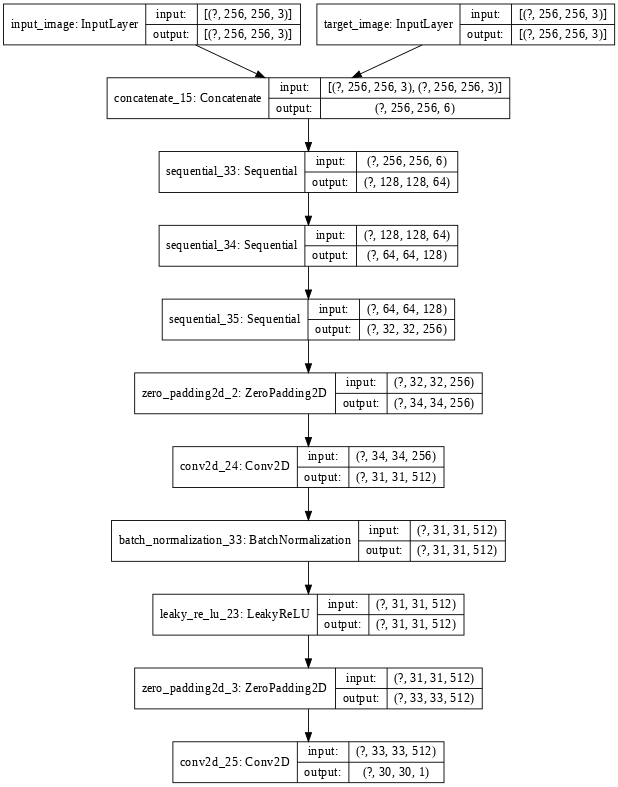

In [ ]:
def Discriminator():
  initializer = tf.random_normal_initializer(0., 0.02)

  inp = tf.keras.layers.Input(shape=[256, 256, 3], name='input_image')
  tar = tf.keras.layers.Input(shape=[256, 256, 3], name='target_image')

  x = tf.keras.layers.concatenate([inp, tar]) # (bs, 256, 256, channels*2)

  down1 = downsample(64, 4, False)(x) # (bs, 128, 128, 64)
  down2 = downsample(128, 4)(down1) # (bs, 64, 64, 128)
  down3 = downsample(256, 4)(down2) # (bs, 32, 32, 256)

  zero_pad1 = tf.keras.layers.ZeroPadding2D()(down3) # (bs, 34, 34, 256)
  conv = tf.keras.layers.Conv2D(512, 4, strides=1,
                                kernel_initializer=initializer,
                                use_bias=False)(zero_pad1) # (bs, 31, 31, 512)

  batchnorm1 = tf.keras.layers.BatchNormalization()(conv)

  leaky_relu = tf.keras.layers.LeakyReLU()(batchnorm1)

  zero_pad2 = tf.keras.layers.ZeroPadding2D()(leaky_relu) # (bs, 33, 33, 512)

  last = tf.keras.layers.Conv2D(1, 4, strides=1,
                                kernel_initializer=initializer)(zero_pad2) # (bs, 30, 30, 1)

  return tf.keras.Model(inputs=[inp, tar], outputs=last)
discriminator = Discriminator()
tf.keras.utils.plot_model(discriminator, show_shapes=True, dpi=64)

In [ ]:
loss_object = tf.keras.losses.BinaryCrossentropy(from_logits=True)
def discriminator_loss(disc_real_output, disc_generated_output):
  real_loss = loss_object(tf.ones_like(disc_real_output), disc_real_output)

  generated_loss = loss_object(tf.zeros_like(disc_generated_output), disc_generated_output)

  total_disc_loss = real_loss + generated_loss

  return total_disc_loss

In [ ]:
generator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

Checkpoint-saver

In [ ]:
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

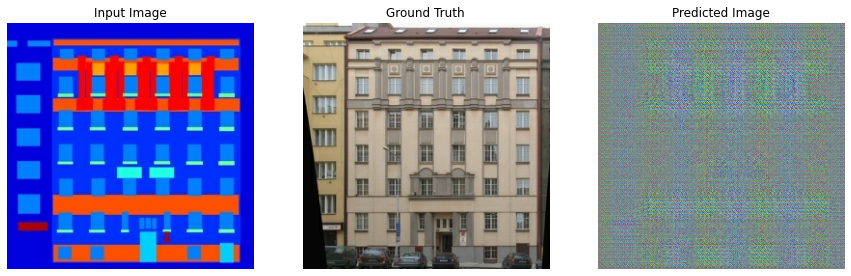

In [ ]:
def generate_images(model, test_input, tar):
  prediction = model(test_input, training=True)
  plt.figure(figsize=(15,15))

  display_list = [test_input[0], tar[0], prediction[0]]
  title = ['Input Image', 'Ground Truth', 'Predicted Image']

  for i in range(3):
    plt.subplot(1, 3, i+1)
    plt.title(title[i])
    # getting the pixel values between [0, 1] to plot it.
    plt.imshow(display_list[i] * 0.5 + 0.5)
    plt.axis('off')
  plt.show()
for example_input, example_target in test_dataset.take(1):
  generate_images(generator, example_input, example_target)

In [ ]:
import datetime
log_dir="logs/"

summary_writer = tf.summary.create_file_writer(
  log_dir + "fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))

In [ ]:
@tf.function
def train_step(input_image, target, epoch):
  with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
    gen_output = generator(input_image, training=True)

    disc_real_output = discriminator([input_image, target], training=True)
    disc_generated_output = discriminator([input_image, gen_output], training=True)

    gen_total_loss, gen_gan_loss, gen_l1_loss = generator_loss(disc_generated_output, gen_output, target)
    disc_loss = discriminator_loss(disc_real_output, disc_generated_output)

  generator_gradients = gen_tape.gradient(gen_total_loss,
                                          generator.trainable_variables)
  discriminator_gradients = disc_tape.gradient(disc_loss,
                                               discriminator.trainable_variables)

  generator_optimizer.apply_gradients(zip(generator_gradients,
                                          generator.trainable_variables))
  discriminator_optimizer.apply_gradients(zip(discriminator_gradients,
                                              discriminator.trainable_variables))

  with summary_writer.as_default():
    tf.summary.scalar('gen_total_loss', gen_total_loss, step=epoch)
    tf.summary.scalar('gen_gan_loss', gen_gan_loss, step=epoch)
    tf.summary.scalar('gen_l1_loss', gen_l1_loss, step=epoch)
    tf.summary.scalar('disc_loss', disc_loss, step=epoch)
EPOCHS=150
def fit(train_ds, epochs, test_ds):
  for epoch in range(epochs):
    start = time.time()

    display.clear_output(wait=True)

    for example_input, example_target in test_ds.take(1):
      generate_images(generator, example_input, example_target)
    print("Epoch: ", epoch)

    # Train
    for n, (input_image, target) in train_ds.enumerate():
      print('.', end='')
      if (n+1) % 100 == 0:
        print()
      train_step(input_image, target, epoch)
    print()

    # saving (checkpoint) the model every 20 epochs
    if (epoch + 1) % 20 == 0:
      checkpoint.save(file_prefix = checkpoint_prefix)

    print ('Time taken for epoch {} is {} sec\n'.format(epoch + 1,
                                                        time.time()-start))
  checkpoint.save(file_prefix = checkpoint_prefix)

In [ ]:
%load_ext tensorboard
%tensorboard --logdir {log_dir}

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 558), started 0:00:22 ago. (Use '!kill 558' to kill it.)

<IPython.core.display.Javascript object>

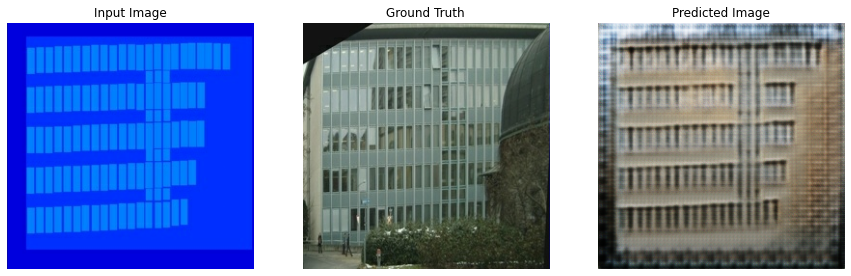

Epoch:  8
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................

Time taken for epoch 9 is 71.79855036735535 sec



In [ ]:
fit(train_dataset, EPOCHS, test_dataset)

In [ ]:
tensorboard dev upload --logdir  {log_dir}

In [ ]:
display.IFrame(
    src="https://tensorboard.dev/experiment/lZ0C6FONROaUMfjYkVyJqw",
    width="100%",
    height="1000px")

In [ ]:
# Run the trained model on a few examples from the test dataset
for inp, tar in test_dataset.take(5):
  generate_images(generator, inp, tar)